<a href="https://colab.research.google.com/github/YueWangpl/MyRepo/blob/master/Eluvio_proj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Eluvio Data Science/ML Project

As I was loading the data, I noticed that all rows are describing different news articles in *worldnews* session from the source website (most likely to be a US owned media company judging from the little coverage of US in the 'worldnews' section) during almost 9 years, from 2008-01-25 to 2016-11-22.  
A question came to me is that, **how much stories of each country are published in the source website?**  
To answer it, I made a new column in the dataframe with country names from the story titles as values. The count with an interactive map of it is presented at the end of this notebook.

## First, import the libraries.

In [1]:
#!pip install geopandas
#!pip install dataprep
#!pip install pycountry
import numpy as np
import pandas as pd
import folium
import branca.colormap as cm
import pycountry
from dataprep.clean import clean_country
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount("/content/gdrive")

NumExpr defaulting to 2 threads.


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
cd /content/gdrive/MyDrive/

/content/gdrive/MyDrive


In [4]:
df = pd.read_csv("Eluvio_DS_Challenge.csv")
df.head(10)

,time_created,date_created,up_votes,down_votes,title,over_18,author,category
0,1201232046,2008-01-25,3,0,Scores killed in Pakistan clashes,False,polar,worldnews
1,1201232075,2008-01-25,2,0,Japan resumes refuelling mission,False,polar,worldnews
2,1201232523,2008-01-25,3,0,US presses Egypt on Gaza border,False,polar,worldnews
3,1201233290,2008-01-25,1,0,Jump-start economy: Give health care to all,False,fadi420,worldnews
4,1201274720,2008-01-25,4,0,Council of Europe bashes EU&UN terror blacklist,False,mhermans,worldnews
5,1201287889,2008-01-25,15,0,Hay presto! Farmer unveils the illegal mock-...,False,Armagedonovich,worldnews
6,1201289438,2008-01-25,5,0,"Strikes, Protests and Gridlock at the Poland-U...",False,Clythos,worldnews
7,1201536662,2008-01-28,0,0,The U.N. Mismanagement Program,False,Moldavite,worldnews
8,1201558396,2008-01-28,4,0,Nicolas Sarkozy threatens to sue Ryanair,False,Moldavite,worldnews
9,1201635869,2008-01-29,3,0,US plans for missile shields in Polish town me...,False,JoeyRamone63,worldnews


## EDA

In [59]:
df.dtypes

time_created     int64
date_created    object
up_votes         int64
down_votes       int64
title           object
over_18           bool
author          object
category        object
cntry           object
dtype: object

In [210]:
np.sum(df['over_18'])

320

In [5]:
df.loc[df['over_18']]

,time_created,date_created,up_votes,down_votes,title,over_18,author,category
1885,1206381438,2008-03-24,189,0,Pics from the Tibetan protests - more graphic ...,True,pressed,worldnews
6721,1211138718,2008-05-18,5,0,"MI5 linked to Max Mosley’s Nazi-style, sadomas...",True,alllie,worldnews
8414,1212694925,2008-06-05,0,0,Tabloid Horrifies Germany: Poland s Yellow Pre...,True,stesch,worldnews
12163,1216672016,2008-07-21,0,0,Love Parade Dortmund: Techno Festival Breaks R...,True,stesch,worldnews
12699,1217381380,2008-07-30,5,0,IDF kills young Palestinian boy. Potentially N...,True,cup,worldnews
...,...,...,...,...,...,...,...,...
503776,1477889966,2016-10-31,4,0,Latest Italian Earthquake Devastates Medieval ...,True,pixelinthe,worldnews
508067,1479400229,2016-11-17,12,0,ISIS Release Video Showing Melbourne As A Poss...,True,halacska,worldnews
508176,1479434681,2016-11-18,0,0,Animal welfare activists have released footage...,True,NinjaDiscoJesus,worldnews
508376,1479492875,2016-11-18,6,0,Jungle Justice : Public lynching of a street ...,True,avivi_,worldnews


Over the 9-year period our data covered, there are only 320 stories that were marked with an age restriction as 18. It seems that most of them are regarded as 'not appropriate for minors' due to potentially disturbing images or videos.

In [37]:
pd.unique(df['category'])

array(['worldnews'], dtype=object)

In [6]:
# strip the \t \n in the title
df = df.applymap(lambda x: x.strip() if isinstance(x, str) else x)

In [7]:
df.sort_values(by=['date_created'])

,time_created,date_created,up_votes,down_votes,title,over_18,author,category
0,1201232046,2008-01-25,3,0,Scores killed in Pakistan clashes,False,polar,worldnews
1,1201232075,2008-01-25,2,0,Japan resumes refuelling mission,False,polar,worldnews
2,1201232523,2008-01-25,3,0,US presses Egypt on Gaza border,False,polar,worldnews
3,1201233290,2008-01-25,1,0,Jump-start economy: Give health care to all,False,fadi420,worldnews
4,1201274720,2008-01-25,4,0,Council of Europe bashes EU&UN terror blacklist,False,mhermans,worldnews
...,...,...,...,...,...,...,...,...
509136,1479795327,2016-11-22,0,0,NATO won’t stop Russian military action as ten...,False,DenTwann,worldnews
509137,1479795511,2016-11-22,3,0,[np] Mark zuckerberg sells $95 mn facebook sha...,False,EarlymanX215,worldnews
509138,1479795583,2016-11-22,3,0,"56-car pile-up in China leaves 17 people dead,...",False,Beejsterb,worldnews
509131,1479793320,2016-11-22,70,0,British PM signals £2bn a year science funding...,False,cyanocittaetprocyon,worldnews


In [31]:
# Create a new df with years
years = (df['date_created'].iloc[:]
         #change data type
         .apply(lambda x: x[:4]).astype('int32')
         #as dataframe
         .to_frame()
         #groupby date with count
         .groupby('date_created').size()
         .reset_index(name='counts'))
years

,date_created,counts
0,2008,22505
1,2009,25115
2,2010,23313
3,2011,38886
4,2012,42643
5,2013,88231
6,2014,92030
7,2015,94621
8,2016,81892


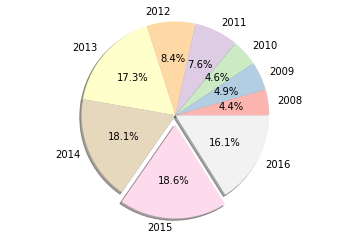

In [40]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = tuple(years['date_created'])
sizes = list(years['counts'])
explode = (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1, 0.0)  
#colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral','#A481CF']
cmap = plt.get_cmap("Pastel1")
colors = cmap(np.arange(39))

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct='%1.1f%%', colors = colors,
        shadow=True, startangle=0, explode = explode)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

In [8]:
len(pd.unique(df['author']))

85838

To conclude this data, it has *time, date, votes, title* and *author* on over 500,000 **worldnews** articles, from year 2008 to year 2016. The most liked story has over 20,000 upvotes and the least has 0. Most of the news is posted in year 2015. Many authors have contributed to more than 1 article for having 86k authors responsible of over 500k published articles.

## Data preperation
Although we've done some data wrangling in the last section, now we can start a new column with country names in the column `title`, with the help of `clean_country` function from library *dataprep*.

In [41]:
df2 = clean_country(df, "title")
df2.head()

Country Cleaning Report:
	327455 values cleaned (64.3%)
	181778 values unable to be parsed (35.7%), set to NaN
Result contains 327458 (64.3%) values in the correct format and 181778 null values (35.7%)


,time_created,date_created,up_votes,down_votes,title,over_18,author,category,title_clean
0,1201232046,2008-01-25,3,0,Scores killed in Pakistan clashes,False,polar,worldnews,Pakistan
1,1201232075,2008-01-25,2,0,Japan resumes refuelling mission,False,polar,worldnews,Japan
2,1201232523,2008-01-25,3,0,US presses Egypt on Gaza border,False,polar,worldnews,Egypt
3,1201233290,2008-01-25,1,0,Jump-start economy: Give health care to all,False,fadi420,worldnews,NaN
4,1201274720,2008-01-25,4,0,Council of Europe bashes EU&UN terror blacklist,False,mhermans,worldnews,NaN


In [42]:
no_country = df2['title_clean'].isnull()
len(df2)-np.sum(no_country)

327458

In [43]:
list_alpha_2 = [i.alpha_2 for i in list(pycountry.countries)]
list_alpha_3 = [i.alpha_3 for i in list(pycountry.countries)] 

There are $327,458$ countries extracted from titles, which is 60% of the article. We can do better by including **"United States"** for *US* and *Trump*, **"China"** for *Tibet* and *Tibetan*, and the country names with abbreviations in the title.

In [44]:
for i in range(len(df2)):
  if no_country[i]:
    ttl = df2['title'][i].split()
    if 'Trump' in ttl:
      df2['title_clean'][i] = 'United States'
    elif ('Tibet' or 'Tibetan') in ttl:
      df2['title_clean'][i] = 'China'
    elif any(ttl) in list_alpha_2:
      df2['title_clean'][i] = pycountry.countries.get(alpha_2=[i for i in ttl if i in list_alpha_2][0]).name
    elif any(ttl) in list_alpha_3:
      df2['title_clean'][i] = pycountry.countries.get(alpha_2=[i for i in ttl if i in list_alpha_3][0]).name
# change column name to country
df2 = df2.rename(columns={'title_clean': 'country'})
df2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,time_created,date_created,up_votes,down_votes,title,over_18,author,category,country
0,1201232046,2008-01-25,3,0,Scores killed in Pakistan clashes,False,polar,worldnews,Pakistan
1,1201232075,2008-01-25,2,0,Japan resumes refuelling mission,False,polar,worldnews,Japan
2,1201232523,2008-01-25,3,0,US presses Egypt on Gaza border,False,polar,worldnews,Egypt
3,1201233290,2008-01-25,1,0,Jump-start economy: Give health care to all,False,fadi420,worldnews,NaN
4,1201274720,2008-01-25,4,0,Council of Europe bashes EU&UN terror blacklist,False,mhermans,worldnews,NaN
...,...,...,...,...,...,...,...,...,...
509231,1479816764,2016-11-22,5,0,Heil Trump : Donald Trump s alt-right white ...,False,nonamenoglory,worldnews,United States
509232,1479816772,2016-11-22,1,0,There are people speculating that this could b...,False,SummerRay,worldnews,NaN
509233,1479817056,2016-11-22,1,0,Professor receives Arab Researchers Award,False,AUSharjah,worldnews,NaN
509234,1479817157,2016-11-22,1,0,Nigel Farage attacks response to Trump ambassa...,False,smilyflower,worldnews,United States


In [45]:
len(df2)-np.sum(df2['country'].isnull())

327854

Now there are $327,854$ rows with at least one country mentioned in their title.

In [46]:
country_cnt = df2.groupby(['country']).size().reset_index(name='counts')
country_cnt

,country,counts
0,Afghanistan,4433
1,Aland Islands,3
2,Albania,196
3,Algeria,663
4,American Samoa,6
...,...,...
243,Western Sahara,43
244,Yemen,3500
245,Zambia,122
246,Zanzibar,23


In [47]:
country_cnt.sort_values(by=['counts'], ascending=False)

,country,counts
45,China,23578
180,Russia,23509
106,Israel,19944
215,Syria,18672
102,Iran,17168
...,...,...
184,San Marino,2
222,Tokelau,2
7,Anguilla,1
136,Martinique,1


We can see that Russia and China are the most-mentioned coutries by the data source, which might be confirming my assumption on the source from a US-held company.

No handles with labels found to put in legend.


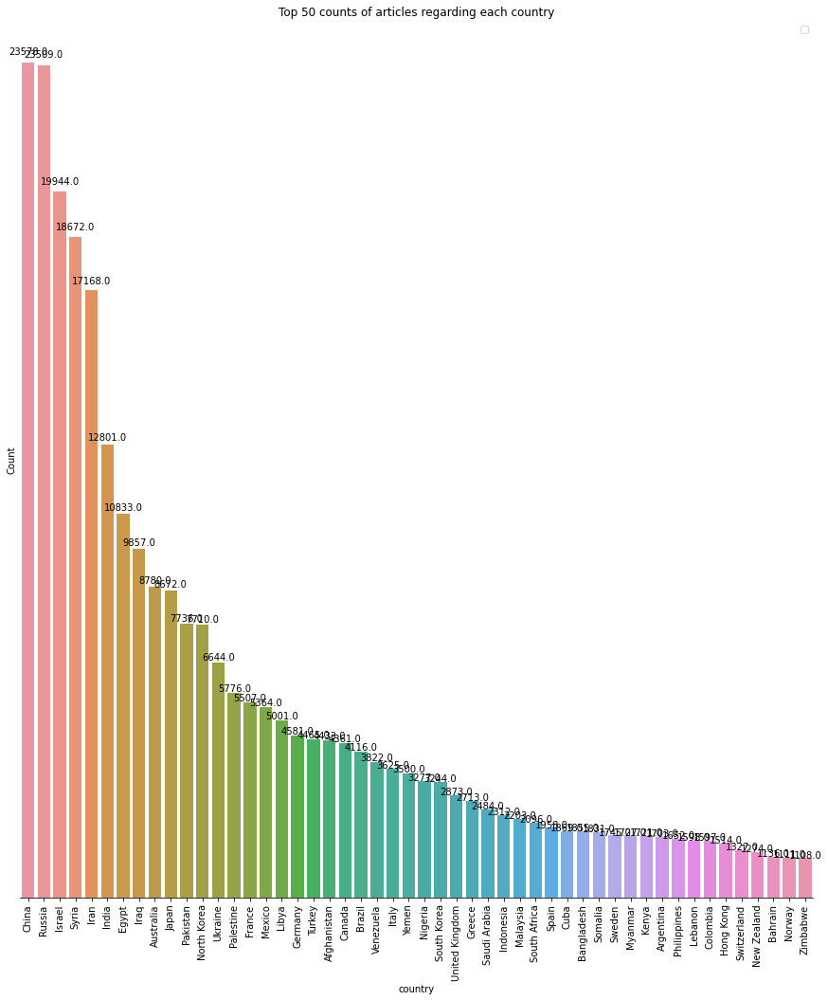

In [48]:
short_cnt = country_cnt.sort_values(by=['counts'], ascending=False).iloc[:50,:]

# Plot the count
fig, ax = plt.subplots(1, 1, figsize = (15, 17))
sns.barplot(x = 'country', y = 'counts', data = short_cnt, ax = ax).set_title("Top 50 counts of articles regarding each country")

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.set_yticks([])
ax.set_xticklabels(short_cnt['country'].tolist(), rotation = 90)
ax.set_ylabel('Count', fontsize='medium') 

for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy() 
    ax.annotate(f'{height}', (x + width/2, y + height*1.01), ha='center')

ax.legend()

## To visualize it on a cleopath map

In [49]:
map_df = gpd.read_file("https://opendata.arcgis.com/datasets/a21fdb46d23e4ef896f31475217cbb08_1.geojson")
map_df.head()

,OBJECTID,CNTRY_NAME,geometry
0,1,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436..."
1,2,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,3,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
3,4,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
4,5,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41..."


In [50]:
# credit: https://towardsdatascience.com/a-beginners-guide-to-create-a-cloropleth-map-in-python-using-geopandas-and-matplotlib-9cc4175ab630
# join the geodataframe with the csv dataframe
merged = map_df.merge(country_cnt, how='left', left_on="CNTRY_NAME", right_on="country")
merged.head()

,OBJECTID,CNTRY_NAME,geometry,country,counts
0,1,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436...",Aruba,16.0
1,2,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ...",Antigua and Barbuda,15.0
2,3,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853...",Afghanistan,4433.0
3,4,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236...",Algeria,663.0
4,5,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41...",Azerbaijan,240.0


Check if any nan values:

In [51]:
np.sum(merged['counts'].isnull())

40

There are 40 NaN values in the 'counts' column! Convert them to 0:

In [52]:
merged['counts'] = merged['counts'].fillna(0)
np.sum(merged['counts'].isnull())

0

Now we are ready to visualize, set the color norm to **lognorm**, because the difference of amount of articles between highly covered countries and barely covered countries is high.

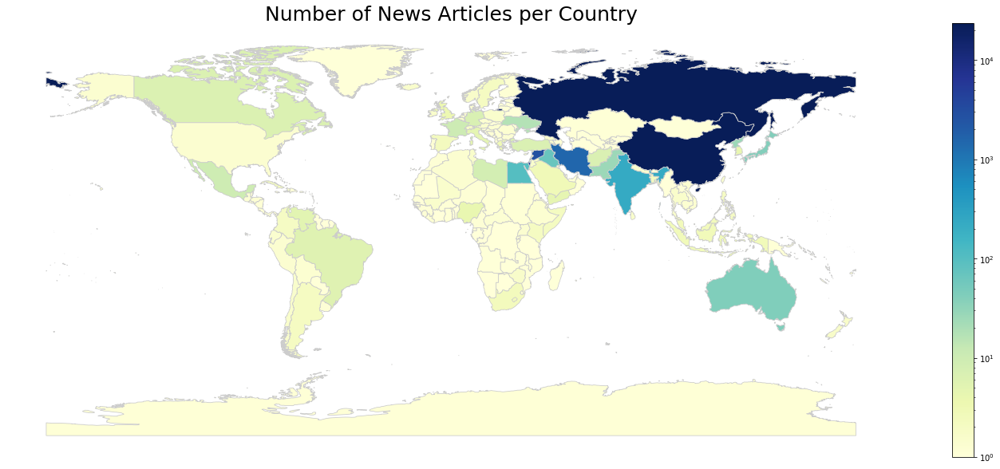

In [61]:
import matplotlib.colors as colors

# set the value column that will be visualised
variable = 'counts'
# set the range for the choropleth values
vmin, vmax = 0, 23509
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(25, 10))
# remove the axis
ax.axis('off')
# add a title and annotation
ax.set_title('Number of News Articles per Country', fontdict={'fontsize': '25', 'fontweight' : '3'})
# ax.annotate('Source: Wikipedia - https://en.wikipedia.org/wiki/Provinces_of_Indonesia', xy=(0.6, .05), xycoords='figure fraction', fontsize=12, color='#555555')
# Create colorbar legend
sm = plt.cm.ScalarMappable(cmap='YlGnBu', norm=colors.LogNorm(vmin=1, vmax=vmax))  # color map: https://matplotlib.org/stable/tutorials/colors/colormaps.html
# empty array for the data range
sm.set_array([]) # or alternatively sm._A = []
# add the colorbar to the figure
fig.colorbar(sm)
# create map
merged.plot(column=variable, cmap='YlGnBu', linewidth=0.8, ax=ax, edgecolor='0.8')

### Interactive map with folium

In [ ]:
# credit: https://vverde.github.io/blob/interactivechoropleth.html
# initiate the map
x_map=merged.centroid.x.mean()
y_map=merged.centroid.y.mean()
print(x_map,y_map)
mymap = folium.Map(location=[y_map+5, x_map], zoom_start=3,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap)

In [55]:
myscale = (merged['counts'].quantile((0, 0.5, 0.7, 0.85, 0.93, 0.95, 0.97, 0.99, 0.995, 1))).tolist()
mymap.choropleth(
 geo_data=merged,
 name='Choropleth',
 data=merged,
 columns=['CNTRY_NAME','counts'],
 key_on="feature.properties.CNTRY_NAME",
 fill_color='YlGnBu',
 threshold_scale=myscale,
 fill_opacity=1,
 line_opacity=0.2,
 legend_name='Counts of News Articles per Country',
 smooth_factor=0
)
mymap

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


With color cut-offs on:

In [56]:
myscale

[0.0, 163.0, 576.0, 1712.0, 4449.0, 6075.5, 9318.5, 19308.0, 22617.75, 23578.0]

Now we can make it interactive so that it shows information when moving cursor on a country.

In [57]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
CNT = folium.features.GeoJson(
    merged,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['CNTRY_NAME','counts'],
        aliases=['Country: ','Number of articles: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
mymap.add_child(CNT)
mymap.keep_in_front(CNT)
folium.LayerControl().add_to(mymap)
mymap